# Preparing set of purchasable compounds

Here, we are using a new funcitonality in RDKit (starting 2024.09.3 release) that enables rapid searching of large combinatorial libraries such as Enamine REAL and ChemSpace's FreedomSpace in synthon form.

In this notebook, we search a 140 billion sized molecule library - FreedomSpace 4.0, all containing potentially purchasable compounds.

# Get compounds and prepare them for docking

### 1. First we import the libraries

In [1]:
#!conda install rdkit mols2grid openbabel
from rdkit import Chem
from rdkit.Chem import rdSynthonSpaceSearch, rdFingerprintGenerator, Draw, PandasTools, AllChem, Crippen
from rdkit.Chem import rdMolDescriptors, rdFMCS, rdMolAlign
import rdkit.Chem.Descriptors as Descriptors
from rdkit.Chem.MolStandardize import rdMolStandardize
from rdkit.Chem.Draw import rdMolDraw2D, rdDepictor
from IPython.display import SVG
from rdkit import rdBase
import mols2grid
import time
from typing import Optional
import os
import pandas as pd
from ipywidgets import interact
from IPython.display import HTML
from openbabel import pybel
import rdkit.DataStructs as DataStructs

rdDepictor.SetPreferCoordGen(True)
print(rdBase.rdkitVersion)

2025.09.1


### Load query molecule

Here, we load the library from PDB ID: 1H1Q and print some information about it.

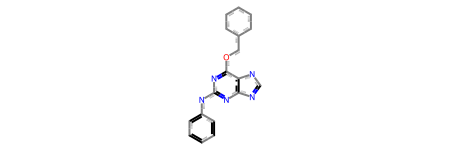

In [2]:
query = Chem.MolFromSmarts("C1=CC=C(NC2=NC3=C(NC=N3)C(OCC3CCCCC3)=N2)C=C1")
Chem.SanitizeMol(query)
query

In [3]:
#Check its basic properties
print("MW:", AllChem.CalcExactMolWt(query))
print("LogP:", Crippen.MolLogP(query))
print("Rotatable Bonds:", rdMolDescriptors.CalcNumRotatableBonds(query))

MW: 302.01028462000005
LogP: 0.6127699999999996
Rotatable Bonds: 5


## Searching Enamine REAL

I visited the https://enaminestore.com/ to make search against the Enamine REAL library containing around 44 billion compounds.

- The search was made based on similarity coefficient of 0.5

- SMILES of the 1h1q ligand was used as the query: ```C1=CC=C(NC2=NC3=C(NC=N3)C(OCC3CCCCC3)=N2)C=C1```

- The results were downloaded in SDF format

### 1. Results from similarity based search

Let's load the SDF file and see what it looks like

In [4]:
frame_og = PandasTools.LoadSDF('data/1h1q-EnamineREAL_similaritySearch.sdf',smilesName='SMILES',molColName='Molecule',
includeFingerprints=True)

print(f'There appears to be {frame_og.shape[0]} hits from Enamine REAL substructure search.')
frame_og.head(3)

There appears to be 1414 hits from Enamine REAL substructure search.


,CatalogID,Name,Storage_temp,Transport_temp,Formula,MW,LOGS,LOGP,Rotating_bonds,FISA,HB_acceptors,HB_donors,Purity,Stock_mg,ID,SMILES,Molecule
0,s_27____25557618____10803818,,,,C[C@H](CN1CCN(C)CC1)NC1=NC(NC2=CC=CC=C2)=C2NC=...,366.5,,2.1292847740000003,6,,7,3,,,,C[C@H](CN1CCN(C)CC1)Nc1nc(Nc2ccccc2)c2[nH]cnc2n1,<rdkit.Chem.rdchem.Mol object at 0x15dc90a50>
1,s_27____15607986____10803818,,,,O=C(CCCNC1=NC(NC2=CC=CC=C2)=C2NC=NC2=N1)N1CCCC1,365.4,,1.8968098820000003,7,,6,3,,,,O=C(CCCNc1nc(Nc2ccccc2)c2[nH]cnc2n1)N1CCCC1,<rdkit.Chem.rdchem.Mol object at 0x15dc926c0>
2,s_27____25520718____10803818,,,,CC(CNC1=NC(NC2=CC=CC=C2)=C2NC=NC2=N1)CC1CCCC1,350.5,,4.692816677666667,7,,5,3,,,,CC(CNc1nc(Nc2ccccc2)c2[nH]cnc2n1)CC1CCCC1,<rdkit.Chem.rdchem.Mol object at 0x15dc910e0>


In [5]:
#We will keep only the necessary columns
frame = frame_og[['Molecule','SMILES','CatalogID','MW','LOGP','Rotating_bonds', 'HB_acceptors', 'HB_donors']].copy()
frame.head(3)

,Molecule,SMILES,CatalogID,MW,LOGP,Rotating_bonds,HB_acceptors,HB_donors
0,<rdkit.Chem.rdchem.Mol object at 0x15dc90a50>,C[C@H](CN1CCN(C)CC1)Nc1nc(Nc2ccccc2)c2[nH]cnc2n1,s_27____25557618____10803818,366.5,2.1292847740000003,6,7,3
1,<rdkit.Chem.rdchem.Mol object at 0x15dc926c0>,O=C(CCCNc1nc(Nc2ccccc2)c2[nH]cnc2n1)N1CCCC1,s_27____15607986____10803818,365.4,1.8968098820000003,7,6,3
2,<rdkit.Chem.rdchem.Mol object at 0x15dc910e0>,CC(CNc1nc(Nc2ccccc2)c2[nH]cnc2n1)CC1CCCC1,s_27____25520718____10803818,350.5,4.692816677666667,7,5,3


In [6]:
#Prepare a separate ID column based on index
frame['index_ID'] = frame.index

In [7]:
#Make sure there are no duplicates based on inchi
frame['InChI'] = frame['Molecule'].apply(lambda x: Chem.MolToInchi(x))
frame = frame.drop_duplicates(subset=['InChI']).reset_index(drop=True)
frame = frame.drop(columns=['InChI'])
print(f'After removing duplicates, we have {frame.shape[0]} hits from Enamine REAL substructure search.')
#frame.head(3)

After removing duplicates, we have 1414 hits from Enamine REAL substructure search.


[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefined stereo

[12:00:44] WARNING: Omitted undefi

### Check structural diversity with respect to the 1H1Q query molecule

For this, we will first compute fingerprint similarities, and for that we'll consider RDKit topological fingerprint: it emphasizes linear paths, rings, and linkers. Good at representing global topology.

- An fp_size of 2048 and maxpath of 5

- maxpath would focus the fingerprint on shorter, local fragments and minimize the influence of overall size and shape.

In [8]:
#Also compute similarity wrt query molecule, with morgan fp with radius 2 and 2048 bits
fpGen = rdFingerprintGenerator.GetRDKitFPGenerator(fpSize=2048, maxPath=2)

#Get fingerprint for query
query_fp = fpGen.GetFingerprint(query)

def compute_fp_sim(row):
    """
    Compute fingerprint similarity between query and molecule in the row.
    """
    mol = row['Molecule']
    mol_fp = fpGen.GetFingerprint(mol)
    sim = DataStructs.TanimotoSimilarity(query_fp, mol_fp)
    return sim

# Compute similarity for each row and store in new column
frame['fp_similarity'] = frame.apply(compute_fp_sim, axis=1)

In [9]:
#Check the new column
frame.head(3)

,Molecule,SMILES,CatalogID,MW,LOGP,Rotating_bonds,HB_acceptors,HB_donors,index_ID,fp_similarity
0,<rdkit.Chem.rdchem.Mol object at 0x15dc90a50>,C[C@H](CN1CCN(C)CC1)Nc1nc(Nc2ccccc2)c2[nH]cnc2n1,s_27____25557618____10803818,366.5,2.1292847740000003,6,7,3,0,0.530612
1,<rdkit.Chem.rdchem.Mol object at 0x15dc926c0>,O=C(CCCNc1nc(Nc2ccccc2)c2[nH]cnc2n1)N1CCCC1,s_27____15607986____10803818,365.4,1.8968098820000003,7,6,3,1,0.472727
2,<rdkit.Chem.rdchem.Mol object at 0x15dc910e0>,CC(CNc1nc(Nc2ccccc2)c2[nH]cnc2n1)CC1CCCC1,s_27____25520718____10803818,350.5,4.692816677666667,7,5,3,2,0.553191


In [10]:
#Get some statistics on fp_similarity
frame.fp_similarity.describe()

count    1414.000000
mean        0.546345
std         0.083736
min         0.285714
25%         0.490566
50%         0.545455
75%         0.612245
max         0.808511
Name: fp_similarity, dtype: float64

The fp_similarity ranges from a minimum of 0.02 to 0.31 and a mean of 0.18. It seems we have some good structural diversity compared to the query molecule.

## Compute histograms

... of all numerical columns, to visualise their distributions

In [11]:
#Convert MW, LOGP, Rotating_bonds, HB_acceptors, HB_donors to numeric (they should be already, but just to be sure)
numeric_cols = ['MW','LOGP','Rotating_bonds', 'HB_acceptors', 'HB_donors']
frame[numeric_cols] = frame[numeric_cols].apply(pd.to_numeric, errors='coerce')

array([[<Axes: title={'center': 'MW'}>, <Axes: title={'center': 'LOGP'}>,
        <Axes: title={'center': 'Rotating_bonds'}>],
       [<Axes: title={'center': 'HB_acceptors'}>,
        <Axes: title={'center': 'HB_donors'}>,
        <Axes: title={'center': 'index_ID'}>],
       [<Axes: title={'center': 'fp_similarity'}>, <Axes: >, <Axes: >]],
      dtype=object)

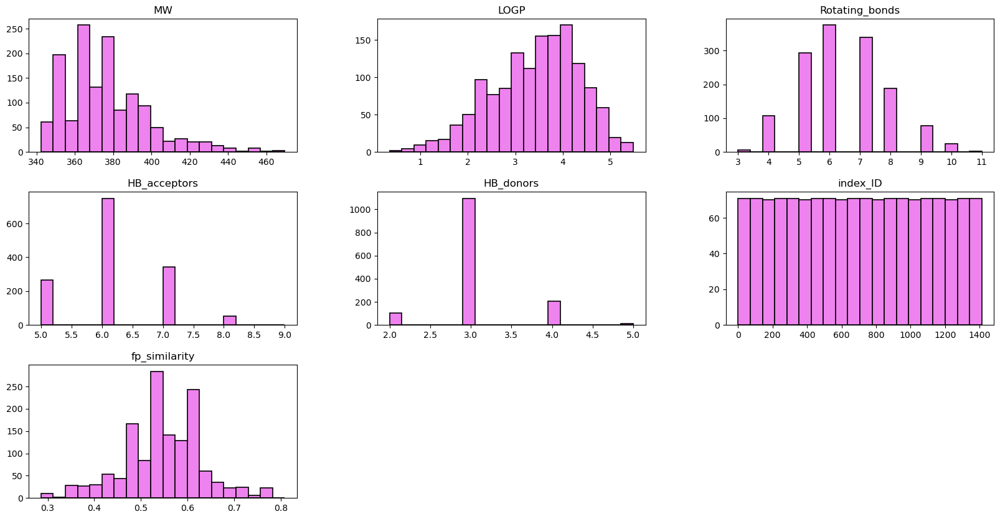

In [12]:
frame.hist(figsize=(20, 10), bins=20, layout=(3, 3), grid=False, edgecolor='black', linewidth=1.2,color='violet')

`Conclusion`: It seems we have a nice structural diversity in the hits, not just based on fp_similarity but also based on other properties like MW, rotatable bonds, etc.

## Let's visualise the molecules

... that we downloaded from the Enamine store

In [13]:
grid = mols2grid.display(frame, mol_col='Molecule', subset=['img','SMILES','index_ID'], size=(250, 250), prerender=True)
HTML(grid._repr_html_())

MolGridWidget()

## Filter and retain top 300

1414 are too many molecules, and many appear to be too different from our query molecule.

We will retain only top 300 as per fp similarity

In [14]:
#Retain only top 300 as per fp similarity
frame_300 = frame.sort_values(by='fp_similarity', ascending=False).head(300).reset_index(drop=True)

#Define RDKit mol column rather than using the "Molecule" column that came from Enamine
frame_300['mol'] = frame_300['SMILES'].apply(Chem.MolFromSmiles)

frame_300.head(3)

,Molecule,SMILES,CatalogID,MW,LOGP,Rotating_bonds,HB_acceptors,HB_donors,index_ID,fp_similarity,mol
0,<rdkit.Chem.rdchem.Mol object at 0x169b8b760>,c1ccc(Nc2nc(N[C@H]3CC[C@H](Oc4cnccn4)CC3)nc3nc...,s_27____12806124____10803818,402.5,2.752762,6,8,3,1261,0.808511,<rdkit.Chem.rdchem.Mol object at 0x1754340b0>
1,<rdkit.Chem.rdchem.Mol object at 0x169b6f300>,c1ccc(Nc2nc(N[C@H]3C[C@@H](Oc4ccccc4)C3)nc3nc[...,s_27____12060302____10803818,372.4,3.558924,6,6,3,1193,0.765957,<rdkit.Chem.rdchem.Mol object at 0x175435310>
2,<rdkit.Chem.rdchem.Mol object at 0x169bce030>,c1ccc(Nc2nc(NCCCOc3ccncc3)nc3nc[nH]c23)cc1,s_27____8925170____10803818,361.4,2.333283,8,7,3,1366,0.765957,<rdkit.Chem.rdchem.Mol object at 0x175434190>


array([[<Axes: title={'center': 'MW'}>, <Axes: title={'center': 'LOGP'}>,
        <Axes: title={'center': 'Rotating_bonds'}>],
       [<Axes: title={'center': 'HB_acceptors'}>,
        <Axes: title={'center': 'HB_donors'}>,
        <Axes: title={'center': 'index_ID'}>],
       [<Axes: title={'center': 'fp_similarity'}>, <Axes: >, <Axes: >]],
      dtype=object)

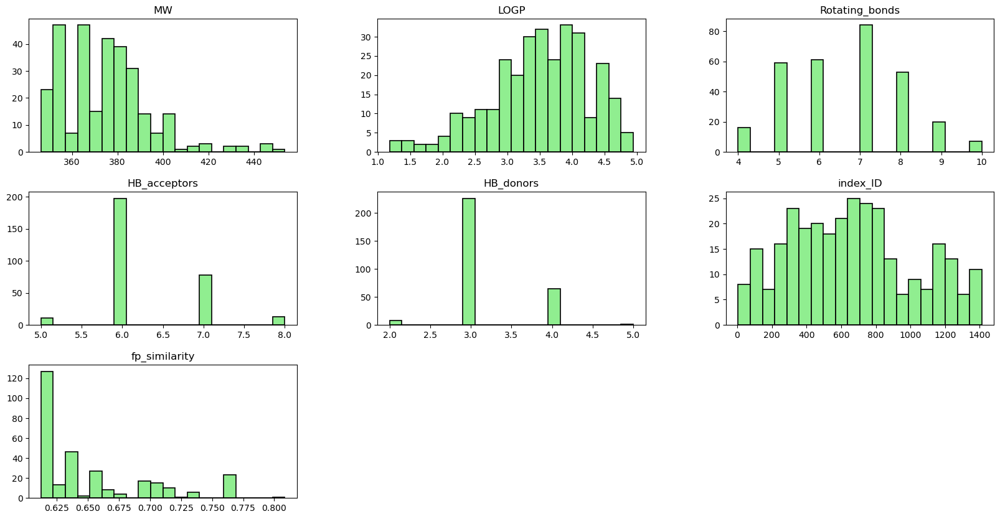

In [15]:
frame_300.hist(figsize=(20, 10), bins=20, layout=(3, 3), grid=False, edgecolor='black', linewidth=1.2,color='lightgreen')

In [16]:
#Visualize top 300 hits
grid = mols2grid.display(frame_300, mol_col='Molecule', subset=['img','SMILES','index_ID','fp_similarity'], size=(250, 250), prerender=True)
HTML(grid._repr_html_())

MolGridWidget()

```Conclusion```: It seems we have a sufficient number of diverse molecules

# Prepare ligands for docking

### 1. Ensure molecules are not duplicated
We have already checked for duplicates based on InChI in one of the cells above. Besides, this dataset was obtained from a single source - the Enamine store, so it is unlikely there would be duplicates in the dataset.

In [17]:
frame_300.head(3)

,Molecule,SMILES,CatalogID,MW,LOGP,Rotating_bonds,HB_acceptors,HB_donors,index_ID,fp_similarity,mol
0,<rdkit.Chem.rdchem.Mol object at 0x169b8b760>,c1ccc(Nc2nc(N[C@H]3CC[C@H](Oc4cnccn4)CC3)nc3nc...,s_27____12806124____10803818,402.5,2.752762,6,8,3,1261,0.808511,<rdkit.Chem.rdchem.Mol object at 0x1754340b0>
1,<rdkit.Chem.rdchem.Mol object at 0x169b6f300>,c1ccc(Nc2nc(N[C@H]3C[C@@H](Oc4ccccc4)C3)nc3nc[...,s_27____12060302____10803818,372.4,3.558924,6,6,3,1193,0.765957,<rdkit.Chem.rdchem.Mol object at 0x175435310>
2,<rdkit.Chem.rdchem.Mol object at 0x169bce030>,c1ccc(Nc2nc(NCCCOc3ccncc3)nc3nc[nH]c23)cc1,s_27____8925170____10803818,361.4,2.333283,8,7,3,1366,0.765957,<rdkit.Chem.rdchem.Mol object at 0x175434190>


### 2. Helper functions

Here, we now define helper functions to:
- Convert SMILES to Mol (and not rely on Enamine's mol object)
- Standardize and uncharge molecules
- Canonicalize tautomers
- Generate 3D coordinates (conformers)
- Minimize the resulting geometry

In [18]:
def smiles_to_mol(smiles: str) -> Optional[Chem.Mol]:
    """
    Converts a SMILES string to an RDKit Mol object.

    Args:
        smiles (str): Molecule SMILES string.

    Returns:
        Chem.Mol or None: RDKit Mol object if valid, else None.
    """
    try:
        mol = Chem.MolFromSmiles(smiles)
        return mol
    except Exception:
        return None

def standardize_molecule(mol: Chem.Mol) -> Optional[Chem.Mol]:
    """
    Standardizes a molecule by normalizing, removing salts, and uncharging.

    Args:
        mol (Chem.Mol): RDKit molecule.

    Returns:
        Chem.Mol or None: Standardized molecule, or None if invalid.
    """
    try:
        normalizer = rdMolStandardize.Normalizer()
        mol = normalizer.normalize(mol)

        lfc = rdMolStandardize.LargestFragmentChooser()
        mol = lfc.choose(mol)

        uncharger = rdMolStandardize.Uncharger()
        mol = uncharger.uncharge(mol)

        return mol
    except Exception:
        return None
    
def canonicalize_tautomer(mol: Chem.Mol) -> Optional[Chem.Mol]:
    """
    Canonicalizes a molecule to its preferred tautomeric form.

    Args:
        mol (Chem.Mol): RDKit molecule.

    Returns:
        Chem.Mol or None: Canonical tautomer, or None if invalid.
    """
    try:
        tautomer_enumerator = rdMolStandardize.TautomerEnumerator()
        mol = tautomer_enumerator.Canonicalize(mol)
        return mol
    except Exception:
        return None
    


### 3. Main Driver Function


In [19]:
def prepare_molecules_for_docking(df: pd.DataFrame, smiles_col: str = "SMILES") -> pd.DataFrame:
    """
    Prepares molecules in the DataFrame for docking:
        - Converts SMILES to Mol
        - Standardizes and uncharges
        - Canonicalizes tautomers

    Args:
        df (pd.DataFrame): DataFrame containing SMILES.
        smiles_col (str): Column name for SMILES strings.

    Returns:
        pd.DataFrame: DataFrame with new columns for prepared molecules.
    """
    results = []

    for i, row in df.iterrows():
        smiles = row[smiles_col]
        mol = smiles_to_mol(smiles)
        if mol is None:
            results.append(None)
            continue

        mol = standardize_molecule(mol)
        mol = canonicalize_tautomer(mol)

        results.append(mol)

    df['mol_prepared'] = results
    return df

In [20]:
if __name__ == "__main__":
    df_prepared = prepare_molecules_for_docking(frame_300, smiles_col="SMILES")

    # Write to file
    PandasTools.WriteSDF(df_prepared, "prepared_molecules.sdf", molColName="mol_prepared", idName = 'index_ID', properties=list(df_prepared.columns))

    print("Docking preparation complete. Output written to prepared_molecules.sdf")

[12:00:48] Initializing Normalizer
[12:00:48] Running Normalizer
[12:00:48] Running LargestFragmentChooser
[12:00:48] Running Uncharger
[12:00:48] Initializing Normalizer
[12:00:48] Running Normalizer
[12:00:48] Running LargestFragmentChooser
[12:00:48] Running Uncharger
[12:00:48] Initializing Normalizer
[12:00:48] Running Normalizer
[12:00:48] Running LargestFragmentChooser
[12:00:48] Running Uncharger
[12:00:48] Initializing Normalizer
[12:00:48] Running Normalizer
[12:00:48] Running LargestFragmentChooser
[12:00:48] Running Uncharger
[12:00:48] Initializing Normalizer
[12:00:48] Running Normalizer
[12:00:48] Running LargestFragmentChooser
[12:00:48] Running Uncharger
[12:00:48] Initializing Normalizer
[12:00:48] Running Normalizer
[12:00:48] Running LargestFragmentChooser
[12:00:48] Running Uncharger
[12:00:48] Initializing Normalizer
[12:00:48] Running Normalizer
[12:00:48] Running LargestFragmentChooser
[12:00:48] Running Uncharger
[12:00:48] Initializing Normalizer
[12:00:48] Ru

Docking preparation complete. Output written to prepared_molecules.sdf


In [21]:
df_prepared.head(3)

,Molecule,SMILES,CatalogID,MW,LOGP,Rotating_bonds,HB_acceptors,HB_donors,index_ID,fp_similarity,mol,mol_prepared
0,<rdkit.Chem.rdchem.Mol object at 0x169b8b760>,c1ccc(Nc2nc(N[C@H]3CC[C@H](Oc4cnccn4)CC3)nc3nc...,s_27____12806124____10803818,402.5,2.752762,6,8,3,1261,0.808511,<rdkit.Chem.rdchem.Mol object at 0x1754340b0>,<rdkit.Chem.rdchem.Mol object at 0x1754294d0>
1,<rdkit.Chem.rdchem.Mol object at 0x169b6f300>,c1ccc(Nc2nc(N[C@H]3C[C@@H](Oc4ccccc4)C3)nc3nc[...,s_27____12060302____10803818,372.4,3.558924,6,6,3,1193,0.765957,<rdkit.Chem.rdchem.Mol object at 0x175435310>,<rdkit.Chem.rdchem.Mol object at 0x17542ace0>
2,<rdkit.Chem.rdchem.Mol object at 0x169bce030>,c1ccc(Nc2nc(NCCCOc3ccncc3)nc3nc[nH]c23)cc1,s_27____8925170____10803818,361.4,2.333283,8,7,3,1366,0.765957,<rdkit.Chem.rdchem.Mol object at 0x175434190>,<rdkit.Chem.rdchem.Mol object at 0x17542ac70>


In [22]:
#Also save the csv
df_prepared.to_csv("prepared_molecules.csv", index=False)

### 4. Check the output SDF

In [23]:
prepared_mols = PandasTools.LoadSDF('prepared_molecules.sdf',smilesName='SMILES',molColName='mol_prepared', includeFingerprints=True)
print(prepared_mols.shape)

(300, 12)


In [24]:
prepared_mols.head(3)

,Molecule,SMILES,CatalogID,MW,LOGP,Rotating_bonds,HB_acceptors,HB_donors,fp_similarity,mol,ID,mol_prepared
0,<rdkit.Chem.rdchem.Mol object at 0x169b8b760>,c1ccc(Nc2nc(N[C@H]3CC[C@H](Oc4cnccn4)CC3)nc3[n...,s_27____12806124____10803818,402.5,2.752762,6,8,3,0.808511,<rdkit.Chem.rdchem.Mol object at 0x1754340b0>,1261,<rdkit.Chem.rdchem.Mol object at 0x177c52c00>
1,<rdkit.Chem.rdchem.Mol object at 0x169b6f300>,c1ccc(Nc2nc(N[C@H]3C[C@@H](Oc4ccccc4)C3)nc3[nH...,s_27____12060302____10803818,372.4,3.558924,6,6,3,0.765957,<rdkit.Chem.rdchem.Mol object at 0x175435310>,1193,<rdkit.Chem.rdchem.Mol object at 0x177c52d50>
2,<rdkit.Chem.rdchem.Mol object at 0x169bce030>,c1ccc(Nc2nc(NCCCOc3ccncc3)nc3[nH]cnc23)cc1,s_27____8925170____10803818,361.4,2.333283,8,7,3,0.765957,<rdkit.Chem.rdchem.Mol object at 0x175434190>,1366,<rdkit.Chem.rdchem.Mol object at 0x177c527a0>


In [25]:
#We see that there are redundant mol object columns: Molecule and mol, so we need to drop them
prepared_mols = prepared_mols.drop(columns=['Molecule', 'mol'])

In [26]:
mols2grid.display(prepared_mols, mol_col='mol_prepared', subset=['img','SMILES'], size=(250, 250), prerender=True)

MolGridWidget()

In [27]:
prepared_mols.head(3)

,SMILES,CatalogID,MW,LOGP,Rotating_bonds,HB_acceptors,HB_donors,fp_similarity,ID,mol_prepared
0,c1ccc(Nc2nc(N[C@H]3CC[C@H](Oc4cnccn4)CC3)nc3[n...,s_27____12806124____10803818,402.5,2.752762,6,8,3,0.808511,1261,<rdkit.Chem.rdchem.Mol object at 0x177c52c00>
1,c1ccc(Nc2nc(N[C@H]3C[C@@H](Oc4ccccc4)C3)nc3[nH...,s_27____12060302____10803818,372.4,3.558924,6,6,3,0.765957,1193,<rdkit.Chem.rdchem.Mol object at 0x177c52d50>
2,c1ccc(Nc2nc(NCCCOc3ccncc3)nc3[nH]cnc23)cc1,s_27____8925170____10803818,361.4,2.333283,8,7,3,0.765957,1366,<rdkit.Chem.rdchem.Mol object at 0x177c527a0>


### Alignment to reference query molecule

Alignment to a reference ligand already occupying the binding pocket is another crucial step in drug discovery, especially if there is a MCS between the reference ligand and the molecules to be docked.

First, we create some helper functions to achieve this

In [28]:
def load_reference(ref_smiles: str, ref_pdb: str):
    """
    Load reference ligand from SMILES and PDB file.

    Args:
        ref_smiles (str): SMILES string of reference ligand.
        ref_pdb (str): Path to reference ligand 3D structure (.pdb).

    Returns:
        tuple: (reference molecule from SMILES, reference molecule from PDB)
    """
    ref_mol_smiles = Chem.MolFromSmiles(ref_smiles)
    ref_mol_pdb = Chem.MolFromPDBFile(ref_pdb, removeHs=False)
    if ref_mol_pdb is None:
        raise ValueError(f"Could not read reference PDB file: {ref_pdb}")
    print("✅ Reference ligand loaded successfully.")
    return ref_mol_smiles, ref_mol_pdb

def get_mcs_core(ref_mol, target_mol):
    """
    Compute the Maximum Common Substructure (MCS) between two molecules.

    Args:
        ref_mol (Mol): Reference molecule (SMILES or 3D).
        target_mol (Mol): Target molecule.

    Returns:
        Mol: MCS core molecule (as RDKit Mol object).
    """
    mcs_result = rdFMCS.FindMCS([ref_mol, target_mol],
                                ringMatchesRingOnly=True,
                                completeRingsOnly=True,
                                matchValences=True)
    if not mcs_result or not mcs_result.smartsString:
        raise ValueError("No MCS found between reference and target molecule.")
    print("✅ MCS computed successfully.")
    return Chem.MolFromSmarts(mcs_result.smartsString)


def generate_3D_structure(mol: Chem.Mol, num_confs: int = 10, max_iters: int = 200) -> Optional[Chem.Mol]:
    """
    Generates 3D conformers for a molecule using the ETKDGv3 algorithm and selects
    the lowest-energy conformer after optimization.

    Args:
        mol (Chem.Mol): Input 2D molecule (no coordinates required).
        num_confs (int): Number of conformers to generate. Default = 10.
        max_iters (int): Maximum iterations for UFF optimization. Default = 200.

    Returns:
        Chem.Mol or None: 3D molecule containing the lowest-energy conformer,
                          or None if embedding fails.
    """
    try:
        # Add hydrogens before 3D embedding
        mol = Chem.AddHs(mol)

        # Define ETKDGv3 parameters for high-quality conformers
        params = AllChem.ETKDGv3()
        params.pruneRmsThresh = 0.5
        params.numThreads = 0  # use all CPU cores
        params.randomSeed = 42

        # Generate multiple conformers
        conf_ids = AllChem.EmbedMultipleConfs(mol, numConfs=num_confs, params=params)

        # Optimize each conformer using UFF
        energies = []
        for cid in conf_ids:
            result = AllChem.UFFOptimizeMolecule(mol, confId=cid, maxIters=max_iters)
            if result == 0:  # 0 means successful convergence
                ff = AllChem.UFFGetMoleculeForceField(mol, confId=cid)
                energies.append((cid, ff.CalcEnergy()))
            else:
                energies.append((cid, float('inf')))

        # Pick the conformer with the lowest energy
        if not energies:
            return None

        min_cid = min(energies, key=lambda x: x[1])[0]

        # Create a copy with only the lowest-energy conformer
        mol_min = Chem.Mol(mol)
        conf = mol.GetConformer(min_cid)
        mol_min.RemoveAllConformers()
        mol_min.AddConformer(conf, assignId=True)

        return mol_min
    except Exception as e:
        print(f"Conformer generation failed: {e}")
        return None

def align_to_reference(ref_mol_3d, target_mol):
    """
    Align target molecule to reference based on MCS.

    Args:
        ref_mol_3d (Mol): Reference molecule with 3D coordinates.
        target_mol (Mol): Target molecule to align.

    Returns:
        tuple: (aligned Mol, RMSD)
    """
    try:
        core = get_mcs_core(ref_mol_3d, target_mol)
        target_mol_3d = generate_3D_structure(target_mol)
        rmsd = rdMolAlign.AlignMol(target_mol_3d, ref_mol_3d, atomMap=[
            (a1, a2) for a1 in ref_mol_3d.GetSubstructMatch(core)
                      for a2 in target_mol_3d.GetSubstructMatch(core)
        ])
        print(f"✅ Molecule aligned successfully with RMSD: {rmsd:.3f} Å \n")
        return target_mol_3d, rmsd
    except Exception as e:
        print(f"⚠️ Alignment failed for molecule: {e}")
        return None, None

def align_dataframe_to_reference(df, ref_smiles, ref_pdb, smiles_col='SMILES', mol_col='mol'):
    """
    Align all molecules in a dataframe to the reference ligand using MCS.

    Args:
        df (pd.DataFrame): DataFrame containing SMILES and Mol columns.
        ref_smiles (str): Reference ligand SMILES.
        ref_pdb (str): Path to reference ligand PDB file.
        smiles_col (str): Name of SMILES column in dataframe.
        mol_col (str): Name of RDKit Mol column in dataframe.

    Returns:
        pd.DataFrame: Updated dataframe with aligned molecules and RMSDs.
    """
    ref_smiles_mol, ref_mol_3d = load_reference(ref_smiles, ref_pdb)
    aligned_mols, rmsds = [], []

    for idx, row in df.iterrows():
        target_mol = row[mol_col]
        aligned_mol, rmsd = align_to_reference(ref_mol_3d, target_mol)
        aligned_mols.append(aligned_mol)
        rmsds.append(rmsd)

    df['aligned_mol'] = aligned_mols
    df['RMSD'] = rmsds
    print("✅ All molecules aligned to reference.")
    return df

def save_aligned_sdf(df, output_path="aligned_molecules.sdf", mol_col='aligned_mol'):
    """
    Save aligned molecules to an SDF file.

    Args:
        df (pd.DataFrame): DataFrame containing aligned molecules.
        output_path (str): Path to output SDF file.
        mol_col (str): Name of the column containing RDKit Mol objects.
    """
    writer = Chem.SDWriter(output_path)
    for _, row in df.iterrows():
        mol = row[mol_col]
        if mol is not None:
            writer.write(mol)
    writer.close()
    print(f"✅ Aligned molecules saved to: {output_path}")

### Now the main function

In [29]:
def main():
    """
    Main function demonstrating full alignment pipeline.
    """
    # Example inputs
    ref_smiles = "C1=CC=C(NC2=NC3=C(NC=N3)C(OCC3CCCCC3)=N2)C=C1"  # reference ligand SMILES
    ref_pdb = "ligand_only_AddH.pdb"  # Path to the 3D structure, generated by adding hydrogens to query molecule coordinates in Pymol

    df_aligned = align_dataframe_to_reference(prepared_mols, ref_smiles, ref_pdb, smiles_col='SMILES', mol_col='mol_prepared')
    
    PandasTools.WriteSDF(df_aligned, "aligned_molecules.sdf", molColName="aligned_mol", properties=list(df_aligned.columns))
    
    #Also save save the dataframe
    df_aligned.to_csv("aligned_molecules.csv", index=False)

    print(df_aligned[['RMSD']].describe())

    print("\nAlignment complete. RMSD summary:")
    print(df_aligned["RMSD"].describe())

if __name__ == "__main__":
    main()

✅ Reference ligand loaded successfully.
✅ MCS computed successfully.
✅ Molecule aligned successfully with RMSD: 5.815 Å 

✅ MCS computed successfully.
✅ Molecule aligned successfully with RMSD: 4.923 Å 

✅ MCS computed successfully.
✅ Molecule aligned successfully with RMSD: 4.718 Å 

✅ MCS computed successfully.
✅ Molecule aligned successfully with RMSD: 5.791 Å 

✅ MCS computed successfully.
✅ Molecule aligned successfully with RMSD: 5.051 Å 

✅ MCS computed successfully.
✅ Molecule aligned successfully with RMSD: 5.313 Å 

✅ MCS computed successfully.
✅ Molecule aligned successfully with RMSD: 4.660 Å 

✅ MCS computed successfully.
✅ Molecule aligned successfully with RMSD: 4.702 Å 

✅ MCS computed successfully.
✅ Molecule aligned successfully with RMSD: 4.815 Å 

✅ MCS computed successfully.
✅ Molecule aligned successfully with RMSD: 6.029 Å 

✅ MCS computed successfully.
✅ Molecule aligned successfully with RMSD: 5.004 Å 

✅ MCS computed successfully.
✅ Molecule aligned successful

In [30]:
df_aligned = pd.read_csv("aligned_molecules.csv")
df_aligned.head(3)

,SMILES,CatalogID,MW,LOGP,Rotating_bonds,HB_acceptors,HB_donors,fp_similarity,ID,mol_prepared,aligned_mol,RMSD
0,c1ccc(Nc2nc(N[C@H]3CC[C@H](Oc4cnccn4)CC3)nc3[n...,s_27____12806124____10803818,402.5,2.752762,6,8,3,0.808511,1261,<rdkit.Chem.rdchem.Mol object at 0x177c52c00>,<rdkit.Chem.rdchem.Mol object at 0x177ce2de0>,5.815457
1,c1ccc(Nc2nc(N[C@H]3C[C@@H](Oc4ccccc4)C3)nc3[nH...,s_27____12060302____10803818,372.4,3.558924,6,6,3,0.765957,1193,<rdkit.Chem.rdchem.Mol object at 0x177c52d50>,<rdkit.Chem.rdchem.Mol object at 0x177ce2930>,4.923074
2,c1ccc(Nc2nc(NCCCOc3ccncc3)nc3[nH]cnc23)cc1,s_27____8925170____10803818,361.4,2.333283,8,7,3,0.765957,1366,<rdkit.Chem.rdchem.Mol object at 0x177c527a0>,<rdkit.Chem.rdchem.Mol object at 0x177c24ef0>,4.717695


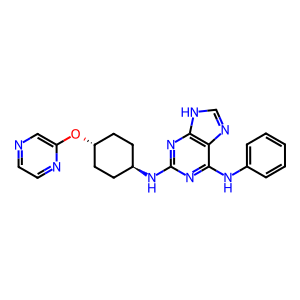

In [35]:
#Get me smiles of ID 1261
Draw.MolToImage(Chem.MolFromSmiles(df_aligned[df_aligned['ID'] == 1261]['SMILES'].values[0]))

### Convert to pdbqt

Meeko prepares the input for AutoDock and processes its output. It is developed alongside AutoDock-GPU and AutoDock-Vina. 

In [31]:
mols = pybel.readfile("sdf", "aligned_molecules.sdf")
#Create a folder to save pdbqt files
import os
os.makedirs("vina_docking_files_for_300ligands", exist_ok=True)

#Name the pdbqt files according to their ID in the dataframe
for i, row in df_aligned.iterrows():
    mol_id = row['ID']
    mol = next(mols)
    mol.addh()  # ensure hydrogens
    mol.calccharges(model='gasteiger')
    mol.write("pdbqt", f"./vina_docking_files_for_300ligands/ligand_{mol_id}.pdbqt", overwrite=True)

print("PDBQT files for Vina docking have been generated and saved in 'vina_docking_files_for_300ligands' folder.")

PDBQT files for Vina docking have been generated and saved in 'vina_docking_files_for_300ligands' folder.
